In [3]:
# plots the original, the compressed (for a selected level) 
# and the difference (averaged over all levels)

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import hdf5plugin  # needed for some h5netcdf files

plt.rcParams["figure.dpi"] = 72   

EXCLUDED_VARS = {"TAITIME", "contacts", "corner_lons", "corner_lats", "anchor"}

def compare_nc_files(original_path: str | Path,
                     compressed_path: str | Path,
                     variables=None,
                     time_idx=0,
                     lev_idx=0,
                     cmap="seismic"):
    o = xr.open_dataset(original_path, engine="h5netcdf", mask_and_scale=False)
    c = xr.open_dataset(compressed_path, engine="h5netcdf", mask_and_scale=False)
    try:
        if variables is None:
            variables = [v for v in o.data_vars if v in c.data_vars and v not in EXCLUDED_VARS]
        if not variables:
            print("Nothing to plot after exclusions.")
            return
    
        for v in variables:
            A, B = o[v], c[v]
            if "time" in A.dims: A = A.isel(time=time_idx)
            if "time" in B.dims: B = B.isel(time=time_idx)
            A, B = xr.align(A, B, join="inner")

            # Original/Compressed at a single level; diff = (B - A) averaged over all levels
            if "lev" in A.dims:
                a2, b2 = A.isel(lev=lev_idx).squeeze(), B.isel(lev=lev_idx).squeeze()
                diff = (B - A).mean("lev").squeeze()
            elif "level" in A.dims:
                a2, b2 = A.isel(level=lev_idx).squeeze(), B.isel(level=lev_idx).squeeze()
                diff = (B - A).mean("level").squeeze()
            else:
                a2, b2 = A.squeeze(), B.squeeze()
                diff = (B - A).squeeze()

            vmin = float(np.nanmin([a2.min().values, b2.min().values]))
            vmax = float(np.nanmax([a2.max().values, b2.max().values]))
            dmax = float(np.nanmax(np.abs(diff.values))) if np.isfinite(diff.values).any() else 0.0

            fig, ax = plt.subplots(1, 3, figsize=(12, 4), constrained_layout=True)
            a2.plot(ax=ax[0], cmap=cmap, vmin=vmin, vmax=vmax); ax[0].set_title(f"Original: {v}")
            b2.plot(ax=ax[1], cmap=cmap, vmin=vmin, vmax=vmax); ax[1].set_title(f"Compressed: {v}")
            if dmax > 0:
                diff.plot(ax=ax[2], cmap="seismic", vmin=-dmax, vmax=dmax)
            else:
                diff.plot(ax=ax[2], cmap="seismic", robust=True)
            ax[2].set_title("Difference (avg over levels)")

            for j in range(3):
                ax[j].set_xlabel("")
                ax[j].set_ylabel("")

            plt.show()
    finally:
        o.close(); c.close()

In [4]:
original_path = "/discover/nobackup/projects/gmao/geos-s2s-3/GiOCEAN_e1/sfc_tavg_3hr_glo_L720x361_sfc/GiOCEAN_e1.sfc_tavg_3hr_glo_L720x361_sfc.monthly.199801.nc4"
compressed_path = "/home/sadhika8/JupyterLinks/nobackup/xbitinf_diagnostics_0.999/compressed_file.nc4"

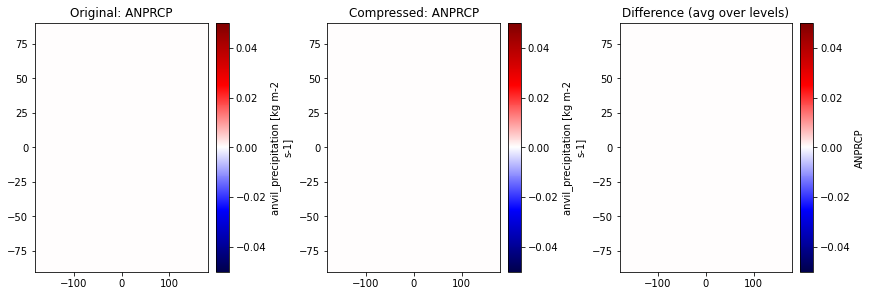

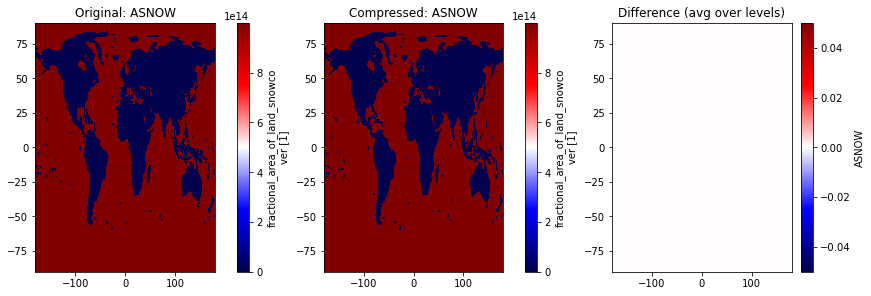

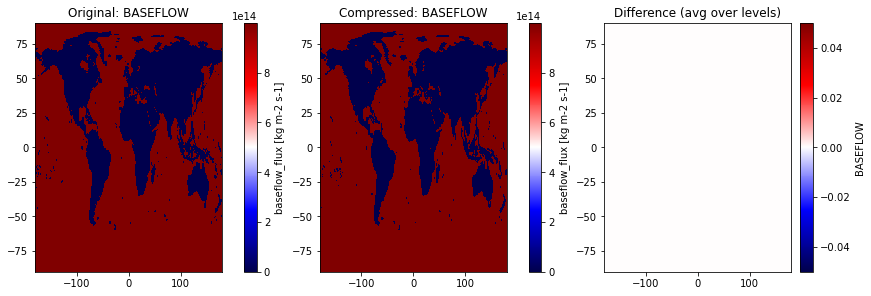

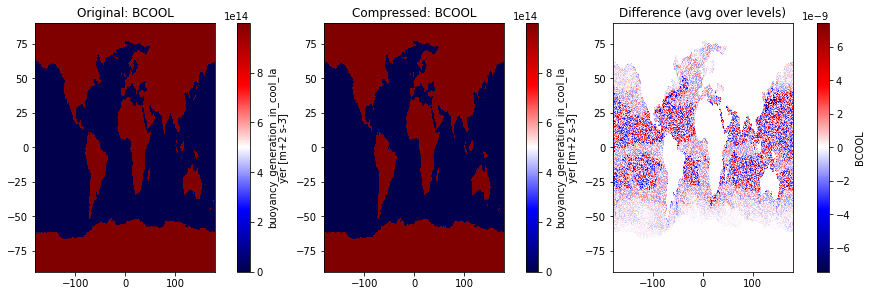

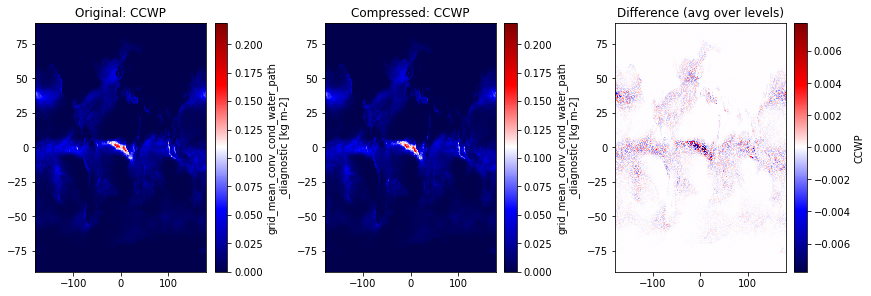

...

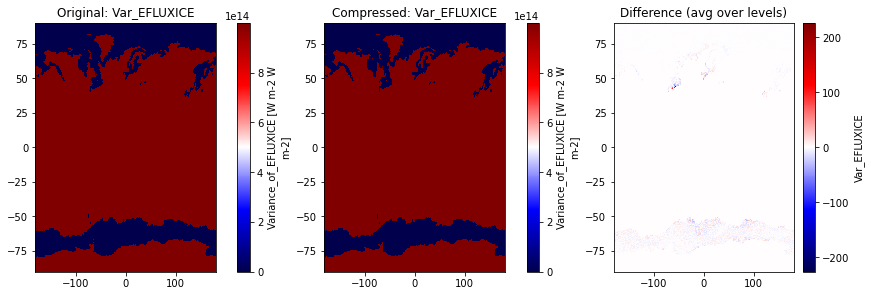

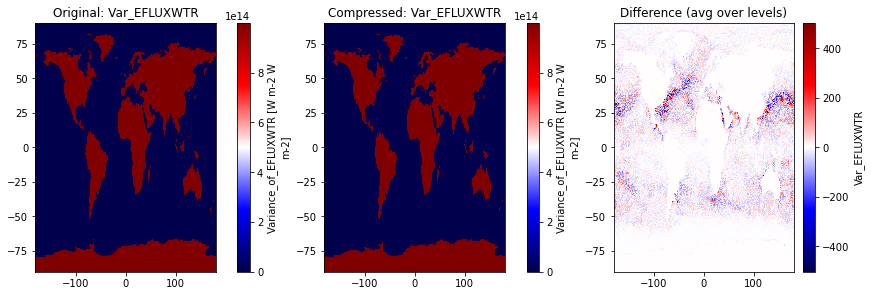

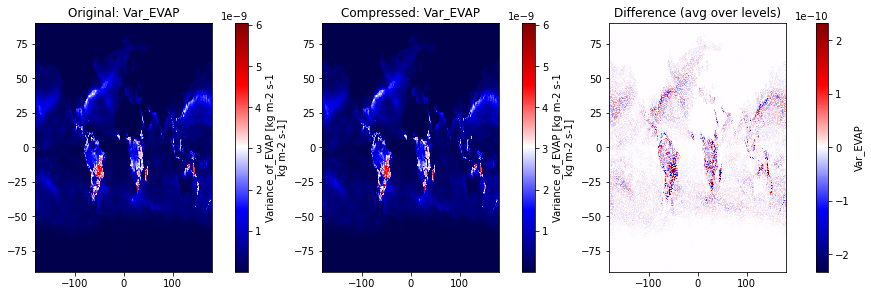

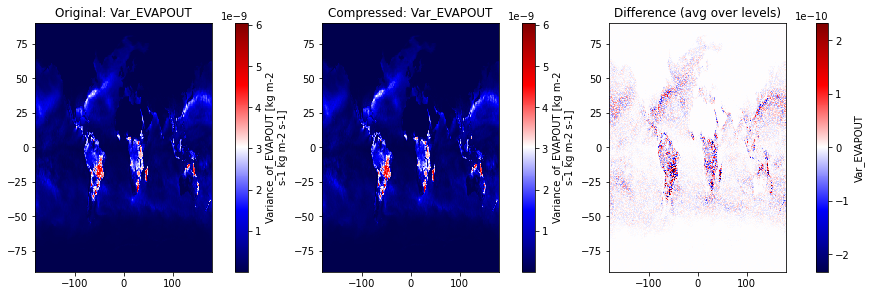

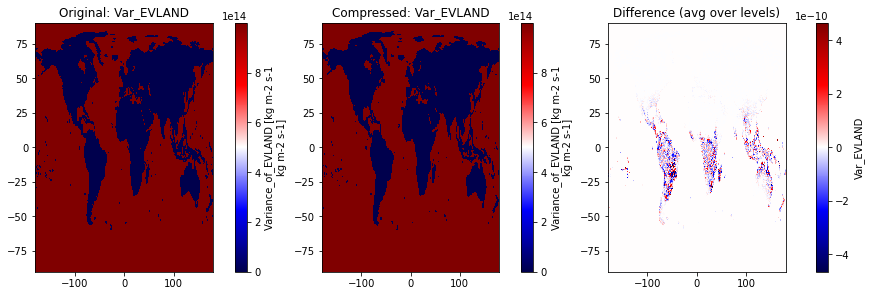

In [ ]:
compare_nc_files(
    original_path=original_path,
    compressed_path=compressed_path)